In [1]:
import json
import requests
import os
import zipfile
import geopandas as gpd 
import pandas as pd
import contextily as cx
import numpy as np
import io
from pandas import json_normalize
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# CLUSTERING POR RESTAURANTES (K-MEANS)

El objetivo principal de este proyecto es lograr dar recomendaciones de posibles ubicaciones para abrir restaurantes de cierto giro.
El primer paso para conseguir esto es usar K-means para agrupar los AGEBs en clusters, utilizando datos de frecuencia de restaurantes y la población total. Estos clusters servirán para identificar patrones y similitudes entre diferentes áreas en términos de la disponibilidad y variedad de restaurantes.

In [2]:
#leemos el archicvo shape de los agebs de Nuevo León
gdf = gpd.read_file("DF_FINAL.shp").to_crs(4326)

In [3]:
gdf.head()

,CVEMA,MUN,NOM_MUN,AGEB,P12A14NOA,P15YM_AN,P18YM_PB,P6A11_NOAM,POBTOT,PSINDER,...,VPH_REFRI,VPH_TELEF,Restaurant,Restaura_1,Restaura_2,Restaura_3,Restaura_4,Restaura_5,Restaura_6,geometry
0,0061882,6,Apodaca,1882,10,67,3404,0,10712,2186,...,2786,1874,0,2,0,3,3,1,3,"POLYGON ((-100.15091 25.71505, -100.15099 25.7..."
1,0061435,6,Apodaca,1435,5,16,4582,4,9224,1185,...,2538,1712,0,0,0,1,1,3,0,"POLYGON ((-100.16946 25.75323, -100.16861 25.7..."
2,0061647,6,Apodaca,1647,3,6,2822,0,4650,638,...,1404,1128,0,0,0,2,1,0,0,"POLYGON ((-100.23345 25.77729, -100.23349 25.7..."
3,0060969,6,Apodaca,0969,0,0,0,0,0,0,...,0,0,8,2,1,3,3,6,0,"POLYGON ((-100.18562 25.77552, -100.18542 25.7..."
4,006030A,6,Apodaca,030A,10,15,2860,7,8268,1230,...,2168,1343,0,1,0,1,0,0,0,"POLYGON ((-100.16562 25.73954, -100.16554 25.7..."


In [4]:
nuevos_nombres = {'Restaurant': 'Rest_Carta',
                  'Restaura_1': 'Rest_Antojitos',
                  'Restaura_2': 'Rest_Mariscos',
                  'Restaura_3': 'Rest_Rapida',
                  'Restaura_4': 'Rest_TacosTortas',
                  'Restaura_5': 'Rest_Autoserv',
                  'Restaura_6': 'Rest_OtrosLlevar',
                  }

gdf.rename(columns=nuevos_nombres, inplace=True)
gdf.head()


,CVEMA,MUN,NOM_MUN,AGEB,P12A14NOA,P15YM_AN,P18YM_PB,P6A11_NOAM,POBTOT,PSINDER,...,VPH_REFRI,VPH_TELEF,Rest_Carta,Rest_Antojitos,Rest_Mariscos,Rest_Rapida,Rest_TacosTortas,Rest_Autoserv,Rest_OtrosLlevar,geometry
0,0061882,6,Apodaca,1882,10,67,3404,0,10712,2186,...,2786,1874,0,2,0,3,3,1,3,"POLYGON ((-100.15091 25.71505, -100.15099 25.7..."
1,0061435,6,Apodaca,1435,5,16,4582,4,9224,1185,...,2538,1712,0,0,0,1,1,3,0,"POLYGON ((-100.16946 25.75323, -100.16861 25.7..."
2,0061647,6,Apodaca,1647,3,6,2822,0,4650,638,...,1404,1128,0,0,0,2,1,0,0,"POLYGON ((-100.23345 25.77729, -100.23349 25.7..."
3,0060969,6,Apodaca,0969,0,0,0,0,0,0,...,0,0,8,2,1,3,3,6,0,"POLYGON ((-100.18562 25.77552, -100.18542 25.7..."
4,006030A,6,Apodaca,030A,10,15,2860,7,8268,1230,...,2168,1343,0,1,0,1,0,0,0,"POLYGON ((-100.16562 25.73954, -100.16554 25.7..."


In [48]:
# columnas relevantes para el clustering
columnas_clustering = ['Rest_Carta',
                       'Rest_Antojitos',
                       'Rest_Mariscos',
                       'Rest_Rapida',
                       'Rest_TacosTortas',
                       'Rest_Autoserv',
                       'Rest_OtrosLlevar',
                       'POBTOT'
                       ]

# creo dataframe solo con las colmnas seleccionadas
datos_clustering = gdf[columnas_clustering]


Debido a que las variables de frecuencia de restaurantes pueden tener diferentes escalas y magnitudes, la normalización garantiza que todas las variables contribuyan equitativamente al cálculo de la distancia entre puntos. Es por esto ue se normalizan los datos para entrenar el modelo. En este caso, estamos utilizando `MinMaxScaler` de `scikit-learn` para normalizar todas las características, incluida la población total. Esto nos permite escalar todas las características al mismo rango ([0, 1] en este caso), lo que puede ser útil para mantener la consistencia en los datos y facilitar la interpretación de los resultados.

In [50]:
from sklearn.preprocessing import MinMaxScaler

In [51]:
"""# Normalizamos los datos
scaler = StandardScaler()
datos_normalizados = scaler.fit_transform(datos_clustering)"""

# Normalizar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
datos_normalizados = scaler.fit_transform(datos_clustering)

# Crear un nuevo DataFrame con los datos normalizados
datos_normalizados_df = pd.DataFrame(datos_normalizados, columns=columnas_clustering)


# PROBANDO DIFERENTES HIPERPARÁMETROS

In [62]:
# Definir hiperparámetros a variar
num_clusters_options = [3, 4, 5]
random_state_options = [0, 42, 100]

# Crear una lista para almacenar temporalmente los resultados
resultados_list = []

# Iterar sobre todas las combinaciones de hiperparámetros
for num_clusters in num_clusters_options:
    for random_state in random_state_options:
        # Crear y entrenar el modelo de KMeans
        kmeans = KMeans(n_clusters=num_clusters, random_state=random_state)
        kmeans.fit(datos_normalizados)
        
        # Agregar las etiquetas del clustering al DataFrame original
        gdf['Cluster'] = kmeans.labels_
        
        # Guardar las etiquetas de los clusters en la lista de resultados
        resultados_list.append({'Num_Clusters': num_clusters,
                                'Random_State': random_state,
                                'Cluster_Labels': kmeans.labels_})

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados_list)

# Visualización de los resultados
print(resultados_df.head())  # Verificar el DataFrame de resultados

c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will chang

   Num_Clusters  Random_State  \
0             3             0   
1             3            42   
2             3           100   
3             4             0   
4             4            42   

                                      Cluster_Labels  
0  [1, 0, 0, 2, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, ...  
1  [0, 0, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 0, 2, 0, ...  
2  [0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, ...  
3  [2, 2, 1, 3, 2, 0, 2, 1, 1, 1, 1, 1, 2, 2, 2, ...  
4  [3, 3, 1, 0, 3, 2, 3, 1, 1, 1, 1, 1, 3, 3, 3, ...  


c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will chang

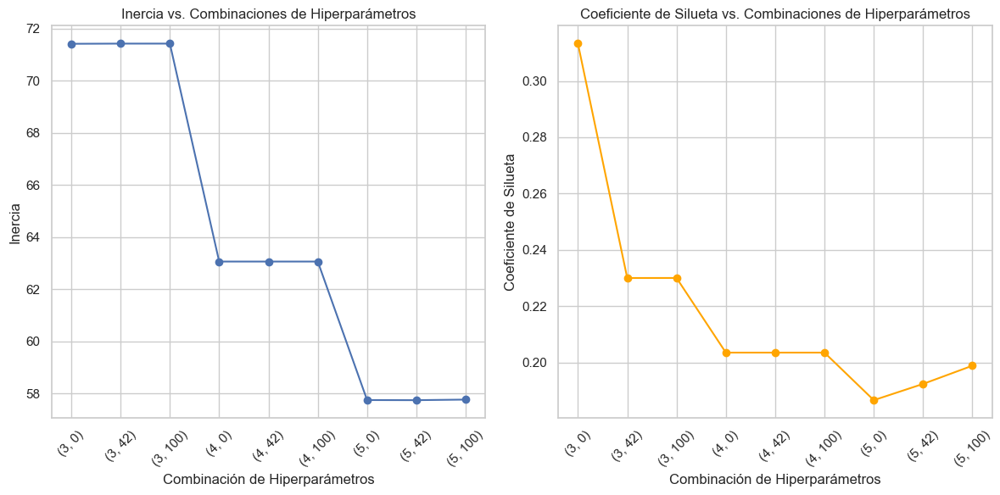

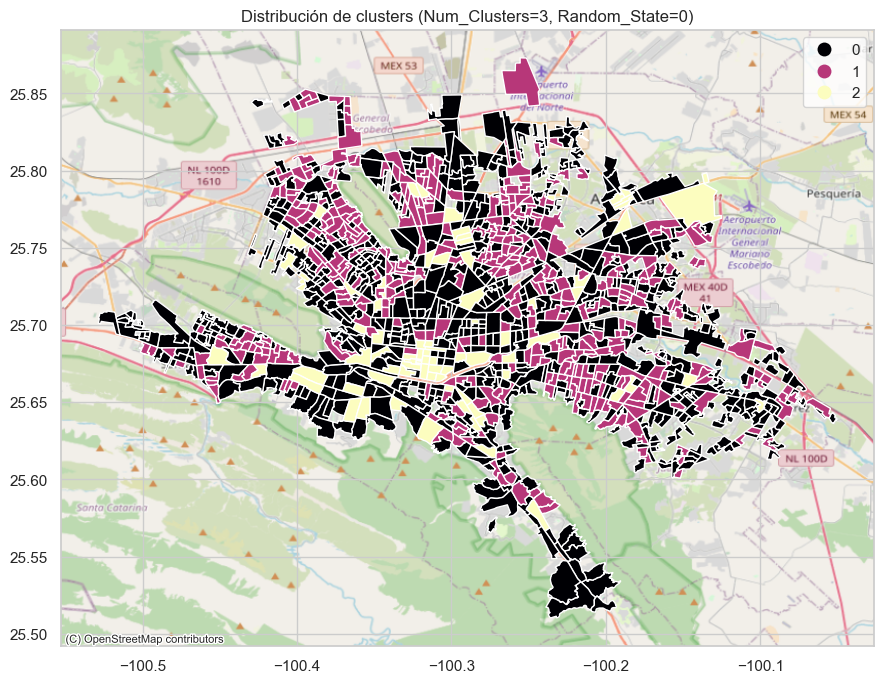

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=3, Random_State=0):
0    806
1    403
2     78
dtype: int64




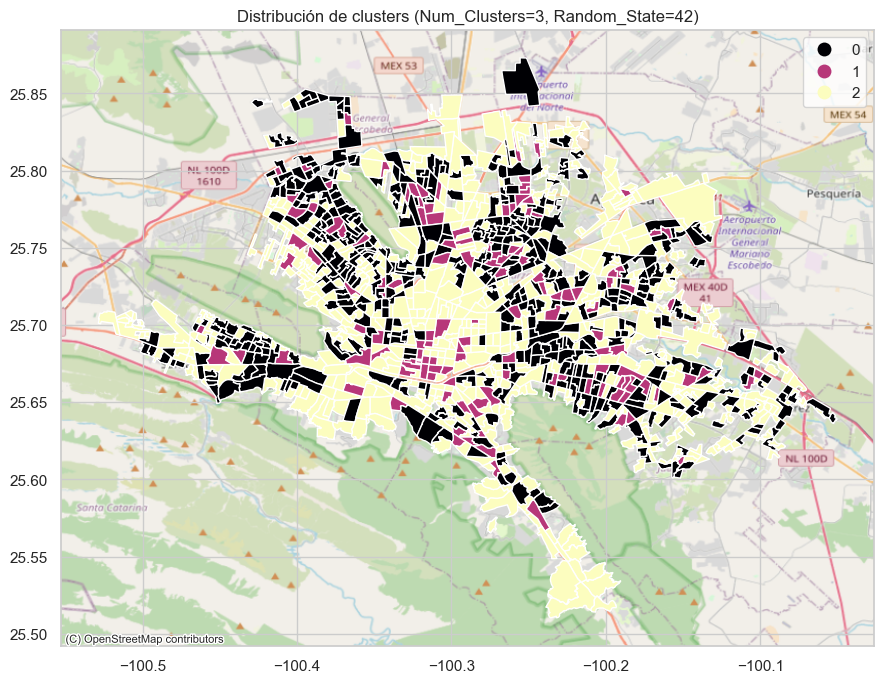

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=3, Random_State=42):
0    519
1    130
2    638
dtype: int64




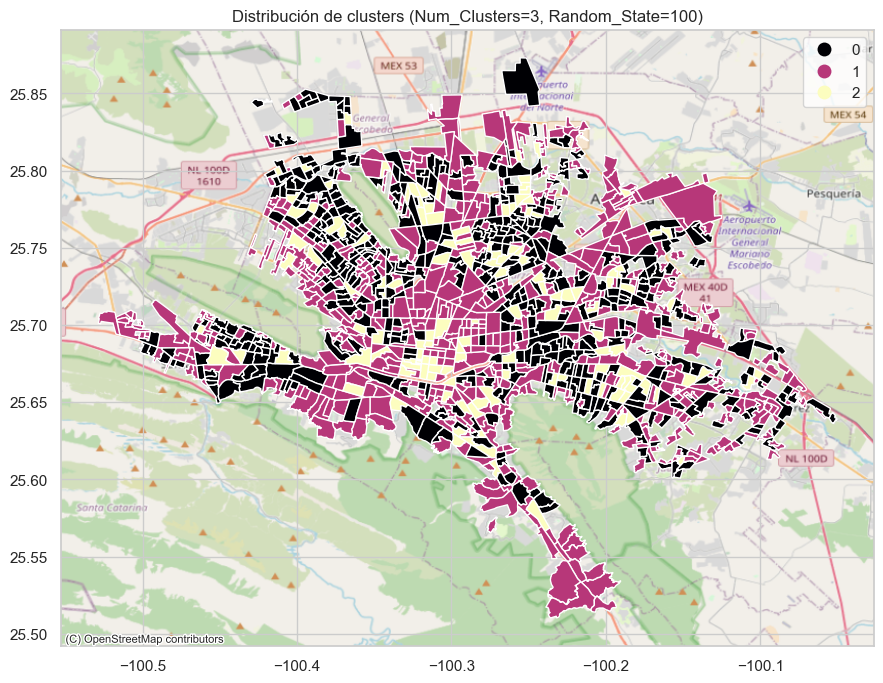

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=3, Random_State=100):
0    518
1    639
2    130
dtype: int64




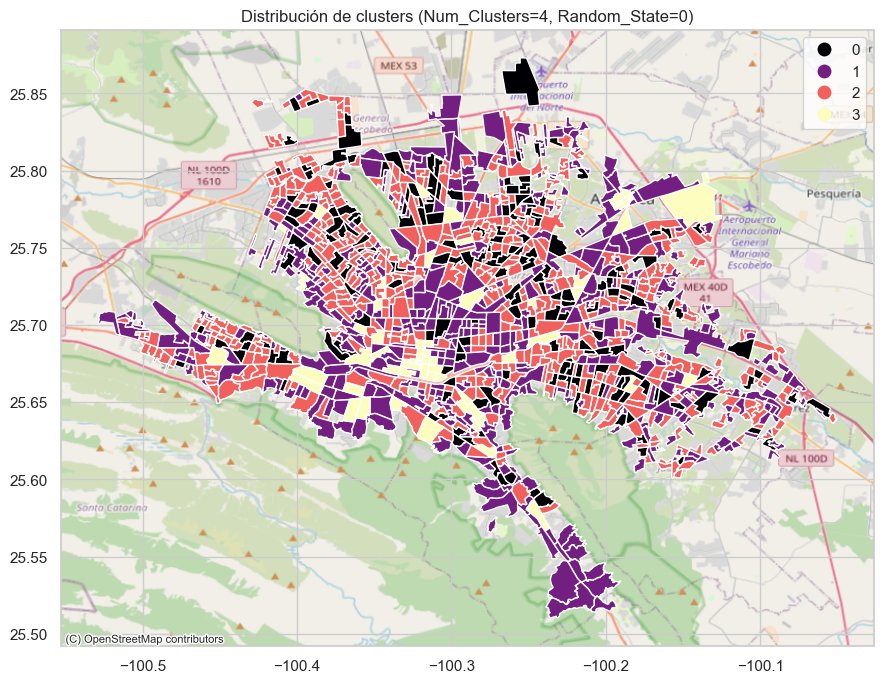

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=4, Random_State=0):
0    194
1    505
2    531
3     57
dtype: int64




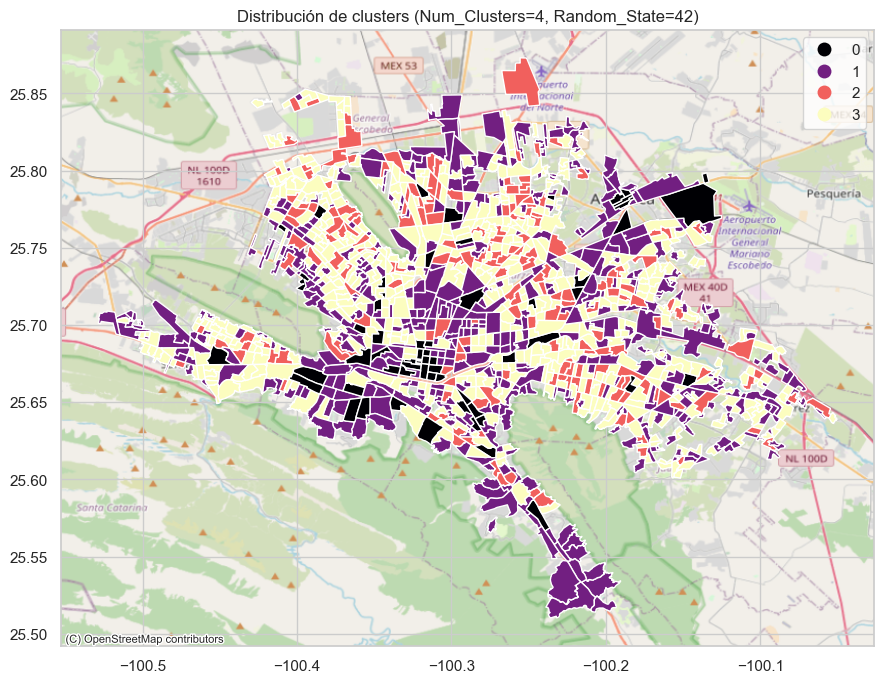

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=4, Random_State=42):
0     57
1    505
2    194
3    531
dtype: int64




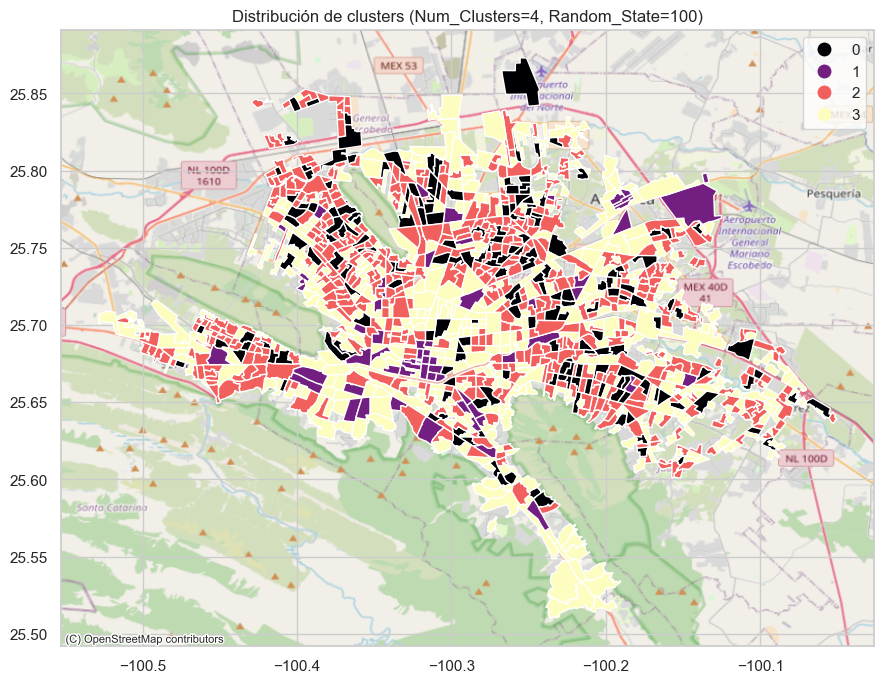

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=4, Random_State=100):
0    194
1     57
2    531
3    505
dtype: int64




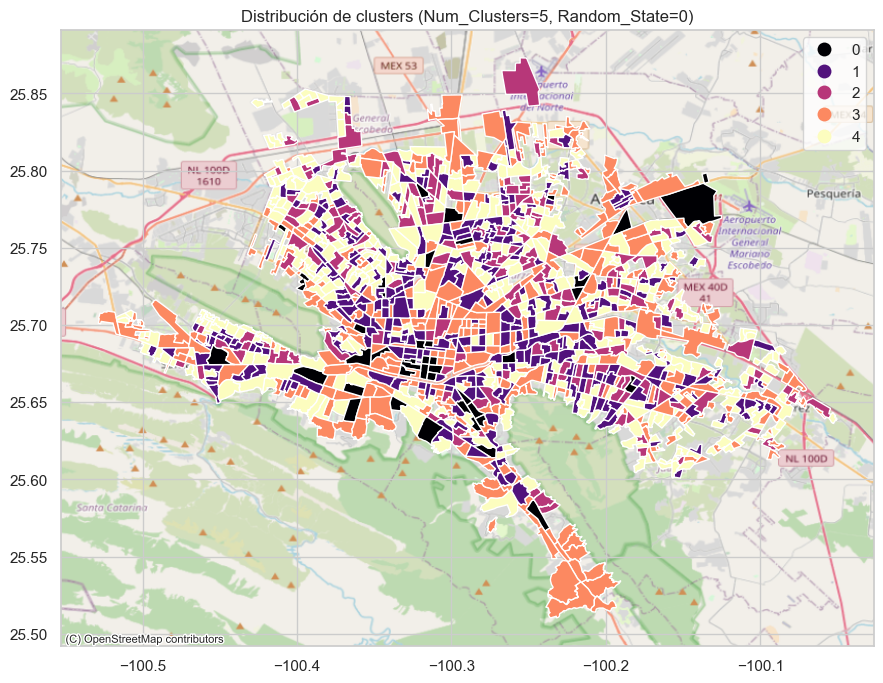

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=5, Random_State=0):
0     40
1    308
2    180
3    378
4    381
dtype: int64




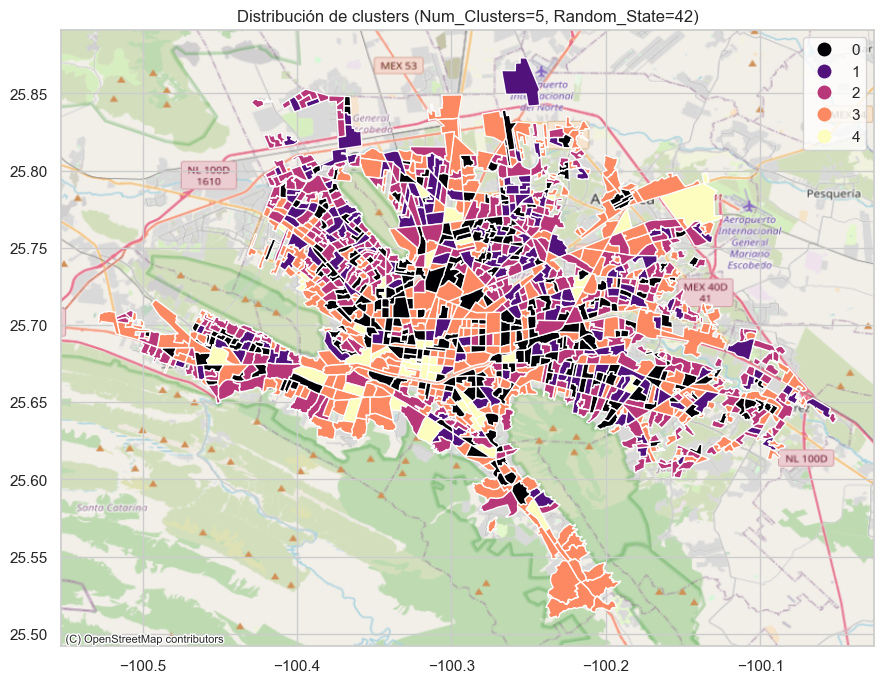

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=5, Random_State=42):
0    284
1    181
2    362
3    420
4     40
dtype: int64




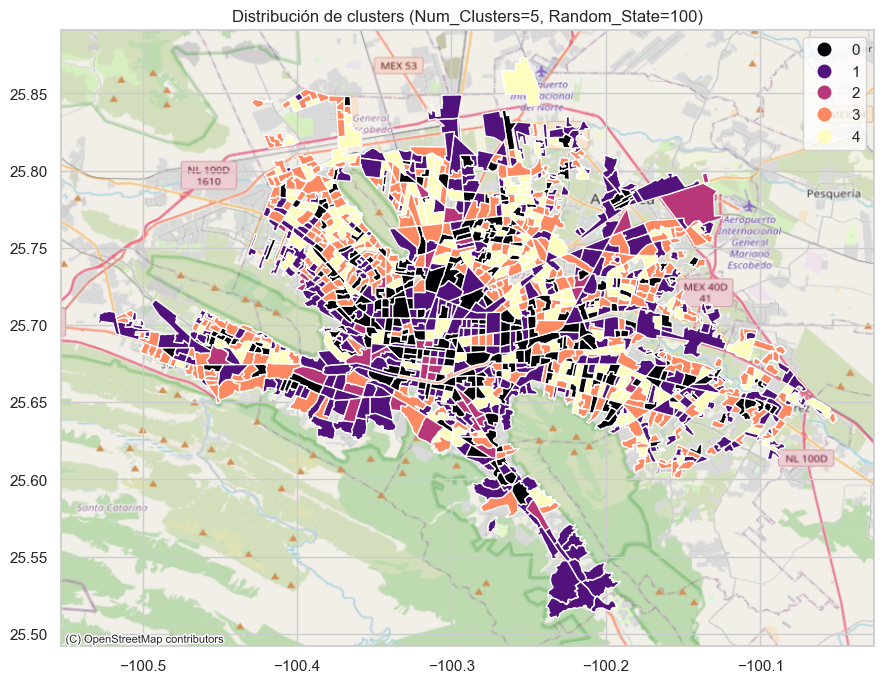

Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters=5, Random_State=100):
0    271
1    441
2     36
3    361
4    178
dtype: int64




In [63]:
from sklearn.metrics import silhouette_score

# Calcular métricas para evaluar los modelos (inercia y coeficiente de silueta)
inercias = []
silhouette_scores = []
for index, row in resultados_df.iterrows():
    kmeans = KMeans(n_clusters=row['Num_Clusters'], random_state=row['Random_State'])
    kmeans.fit(datos_normalizados)
    inercias.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(datos_normalizados, kmeans.labels_))

# Graficar las métricas
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(range(len(resultados_df)), inercias, marker='o')
plt.xticks(range(len(resultados_df)), labels=[f"({row['Num_Clusters']}, {row['Random_State']})" for _, row in resultados_df.iterrows()], rotation=45)
plt.title('Inercia vs. Combinaciones de Hiperparámetros')
plt.xlabel('Combinación de Hiperparámetros')
plt.ylabel('Inercia')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(range(len(resultados_df)), silhouette_scores, marker='o', color='orange')
plt.xticks(range(len(resultados_df)), labels=[f"({row['Num_Clusters']}, {row['Random_State']})" for _, row in resultados_df.iterrows()], rotation=45)
plt.title('Coeficiente de Silueta vs. Combinaciones de Hiperparámetros')
plt.xlabel('Combinación de Hiperparámetros')
plt.ylabel('Coeficiente de Silueta')
plt.grid(True)

plt.tight_layout()
plt.show()

# Visualización de la distribución de clusters para cada combinación de hiperparámetros
for index, row in resultados_df.iterrows():
    ax = gdf.plot(row['Cluster_Labels'], cmap="magma", legend=True, figsize=(14, 8), categorical=True)
    cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.OpenStreetMap.Mapnik)
    plt.title(f"Distribución de clusters (Num_Clusters={row['Num_Clusters']}, Random_State={row['Random_State']})")
    plt.show()

    # Calcular y mostrar la distribución de frecuencias de cada cluster
    freq_por_cluster = gdf.groupby(row['Cluster_Labels']).size()
    print(f"Distribución de frecuencias de AGEBS para la combinación de hiperparámetros (Num_Clusters={row['Num_Clusters']}, Random_State={row['Random_State']}):")
    print(freq_por_cluster)
    print("\n")


## Conclusiones

### Inercia vs. Combinaciones de Hiperparámetros
- Podemos observar que la inercia disminuye a medida que aumenta el número de clusters (`Num_Clusters`) en general. Esto es esperado, ya que a medida que aumentamos el número de clusters, es más probable que cada punto esté más cerca de su centroide más cercano, lo que reduce la inercia.

### Coeficiente de Silueta vs. Combinaciones de Hiperparámetros
- El coeficiente de silueta mide qué tan bien separados están los clusters. Un valor alto indica que los clusters están bien definidos y que los puntos dentro de cada cluster están cerca unos de otros, mientras que un valor bajo indica que los clusters están superpuestos o que los puntos están más cerca de los puntos de otros clusters.
- Observamos que hay fluctuaciones en el coeficiente de silueta para diferentes combinaciones de hiperparámetros. En general, las combinaciones de hiperparámetros con `Num_Clusters=3` muestran los coeficientes de silueta más altos, lo que sugiere que estos modelos generan clusters más definidos en comparación con otras combinaciones.

### Conclusión General
Basándonos en las métricas de inercia y coeficiente de silueta, las combinaciones de hiperparámetros con `Num_Clusters=3` y `Random_State=0` parece ser las más adecuadas para este conjunto de datos. Estas configuraciones producen clusters más compactos y bien definidos en comparación con otras configuraciones de hiperparámetros. No obstante, es crucial considerar otras métricas y realizar un análisis visual para validar estas conclusiones y seleccionar el modelo final.

# ETIQUETAS CON MEJORES HIPERPARÁMETROS OBTENIDOS

In [84]:
# número de clusters
num_clusters = 3

# se crea el modelo de k-means y se entrena el modelo
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
kmeans.fit(datos_normalizados)

c:\Users\alexa\anaconda3\envs\tecmx\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=3, random_state=0)

In [85]:
# se agregan las etiquetas del clustering al df original
gdf['Cluster'] = kmeans.labels_

# distribución de los clusters
print(gdf['Cluster'].value_counts())

Cluster
0    806
1    403
2     78
Name: count, dtype: int64


In [86]:
import matplotlib.pyplot as plt

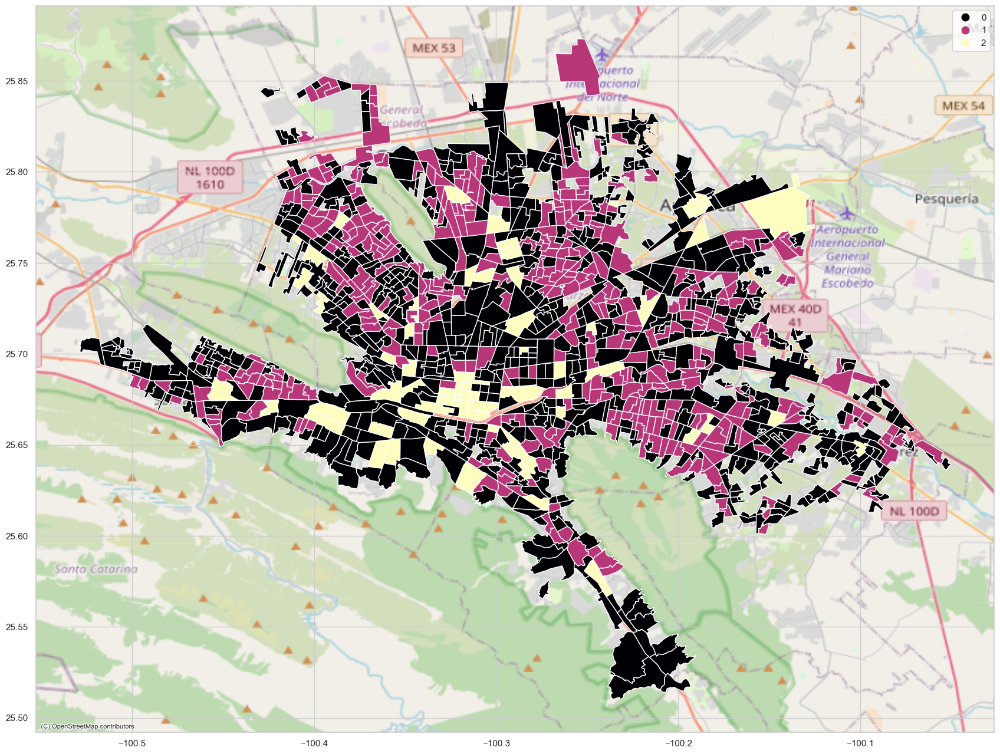

In [87]:
#mostrar clusters en el mapa
ax = gdf.plot("Cluster", cmap="magma", legend=True, figsize=(28, 16), categorical =True)
cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.OpenStreetMap.Mapnik)

In [88]:
# se seleccionan las columnas numéricas relevantes para el clustering 
columnas_numericas = gdf.select_dtypes(include=np.number).columns.tolist()
columnas_numericas.remove('Cluster')

# se calcula el promedio de cada variable numérica para cada cluster
medias_por_cluster = gdf.groupby('Cluster')[columnas_numericas].mean()

# solo las columnas de restaurantes
columnas_restaurantes = ['Rest_Carta',
                       'Rest_Antojitos',
                       'Rest_Mariscos',
                       'Rest_Rapida',
                       'Rest_TacosTortas',
                       'Rest_Autoserv',
                       'Rest_OtrosLlevar',
                       ]
medias_restaurantes_por_cluster = medias_por_cluster[columnas_restaurantes]

# Muestra las medias de frecuencia de restaurantes por cluster
medias_restaurantes_por_cluster

,Rest_Carta,Rest_Antojitos,Rest_Mariscos,Rest_Rapida,Rest_TacosTortas,Rest_Autoserv,Rest_OtrosLlevar
Cluster,,,,,,,
0,1.038462,0.739454,0.241935,0.952854,2.297767,0.260546,0.368486
1,1.129032,2.550868,0.521092,3.796526,5.888337,0.439206,0.704715
2,11.653846,3.756410,2.064103,3.282051,9.525641,3.974359,2.012821


In [89]:
medias_restaurantes_por_cluster.reset_index(inplace=True)
medias_restaurantes_melted = pd.melt(medias_restaurantes_por_cluster, id_vars=['Cluster'], var_name='Tipo de Restaurante', value_name='Frecuencia Promedio')

In [90]:
import seaborn as sns

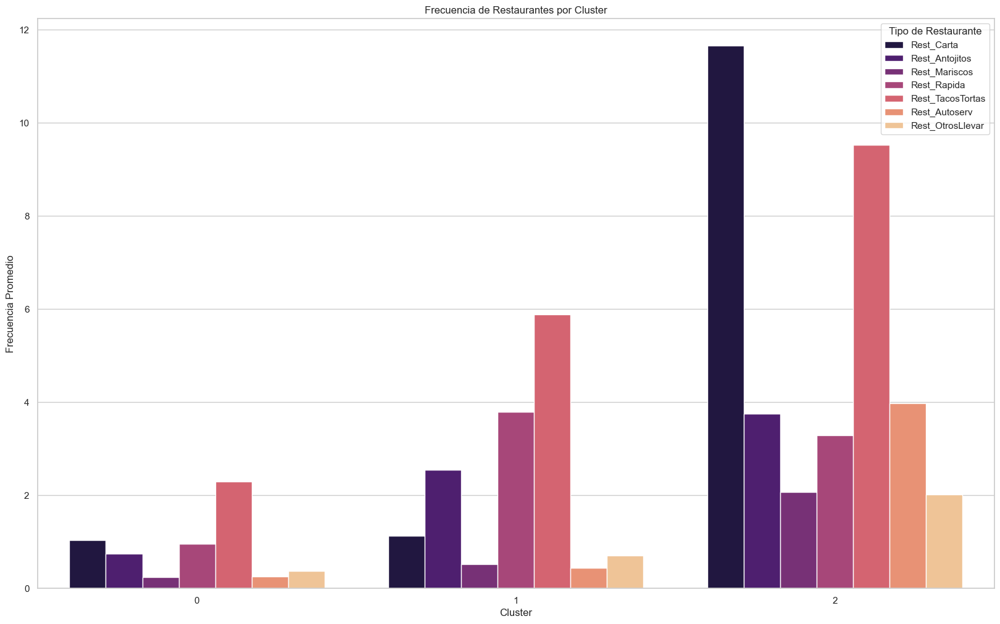

In [91]:
# Configuración de estilo de Seaborn
sns.set(style="whitegrid")

# Gráfico de barras para las medias de frecuencia de restaurantes por cluster
plt.figure(figsize=(20, 12))
sns.barplot(data=medias_restaurantes_melted, 
            x='Cluster', y='Frecuencia Promedio', hue='Tipo de Restaurante', palette='magma')
plt.title('Frecuencia de Restaurantes por Cluster')
plt.xlabel('Cluster')
plt.ylabel('Frecuencia Promedio')
plt.legend(title='Tipo de Restaurante')
plt.xticks(rotation=0)  # Rotar etiquetas del eje x
plt.show()

## Interpretación de Resultados

*   **Cluster 2:** Tiene una frecuencia relativamente alta en todos los tipos de restaurantes, especialmente en los de alimentos a la carta o de comida corrida, tacos y tortas, y de autoservicio. Esto sugiere una zona con una variedad amplia de opciones de comida, que podría ser un área comercial o residencial densamente poblada.

*   **Cluster 1:** Tiene frecuencias moderadas en la mayoría de los tipos de restaurantes, con las más altas en restaurantes de pizzas, hamburguesas, hot dogs y pollos rostizados, y tacos y tortas. Esto podría indicar un área más equilibrada en términos de opciones de comida, posiblemente una combinación de áreas residenciales y comerciales.

*   **Cluster 0:** Tiene las frecuencias más bajas en general, con las más altas en restaurantes de tacos y tortas, alimentos a la carta o de comida corrida. Esto sugiere un área con menos opciones de comida y posiblemente menos densamente poblada, como áreas suburbanas o rurales.


# RELACIÓN PERSONAS POR RESTAURANTES

Una vez que se tienen agrupados los AGEBS por tipo de restaurante se busca calcular la relación entre el total de habitantes y el total de restaurantes para cada AGEB. Entre mayor sea la proporción, menor será el número de restaurantes por persona en ese AGEB, y mayor será la oportunidad para iniciar un restaurante que satisfaga la demanda de la zona.

In [92]:
total_restaurantes = ['Rest_Carta',
                       'Rest_Antojitos',
                       'Rest_Mariscos',
                       'Rest_Rapida',
                       'Rest_TacosTortas',
                       'Rest_Autoserv',
                       'Rest_OtrosLlevar',
                       ]

gdf['Tot_Rest'] = gdf[total_restaurantes].sum(axis=1)

In [93]:
gdf['POBREST'] = gdf['POBTOT'] / gdf['Tot_Rest'] 
gdf.head()

,CVEMA,MUN,NOM_MUN,AGEB,P12A14NOA,P15YM_AN,P18YM_PB,P6A11_NOAM,POBTOT,PSINDER,...,Rest_Antojitos,Rest_Mariscos,Rest_Rapida,Rest_TacosTortas,Rest_Autoserv,Rest_OtrosLlevar,geometry,Cluster,Tot_Rest,POBREST
0,0061882,6,Apodaca,1882,10,67,3404,0,10712,2186,...,2,0,3,3,1,3,"POLYGON ((-100.15091 25.71505, -100.15099 25.7...",1,12,892.666667
1,0061435,6,Apodaca,1435,5,16,4582,4,9224,1185,...,0,0,1,1,3,0,"POLYGON ((-100.16946 25.75323, -100.16861 25.7...",0,5,1844.800000
2,0061647,6,Apodaca,1647,3,6,2822,0,4650,638,...,0,0,2,1,0,0,"POLYGON ((-100.23345 25.77729, -100.23349 25.7...",0,3,1550.000000
3,0060969,6,Apodaca,0969,0,0,0,0,0,0,...,2,1,3,3,6,0,"POLYGON ((-100.18562 25.77552, -100.18542 25.7...",2,23,0.000000
4,006030A,6,Apodaca,030A,10,15,2860,7,8268,1230,...,1,0,1,0,0,0,"POLYGON ((-100.16562 25.73954, -100.16554 25.7...",0,2,4134.000000


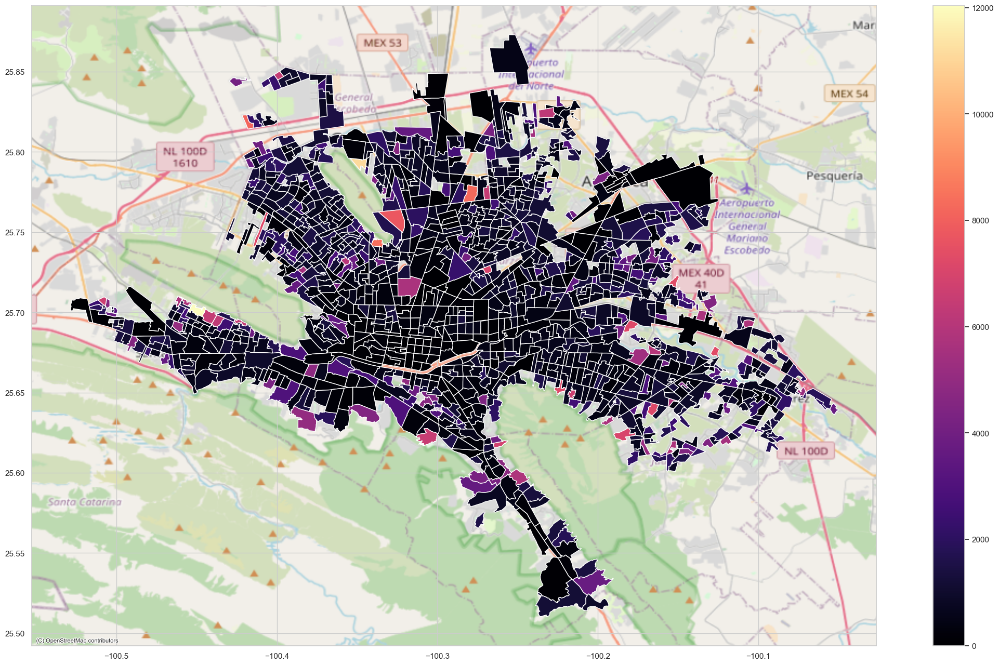

In [94]:
#mostrar Personas por restaurante
ax = gdf.plot("POBREST", cmap="magma", legend=True, figsize=(28, 16))
cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.OpenStreetMap.Mapnik)

In [95]:
gdf[['Tot_Rest','POBREST','POBTOT']].describe()

,Tot_Rest,POBREST,POBTOT
count,1287.000000,1287.000000,1287.000000
mean,10.599068,1169.735322,5900.272727
std,10.603233,1395.272537,3241.195867
min,1.000000,0.000000,0.000000
25%,4.000000,364.357143,3731.000000
50%,8.000000,691.200000,5808.000000
75%,14.000000,1373.321429,7866.000000
max,151.000000,12038.000000,22586.000000


## OUTLIERS 

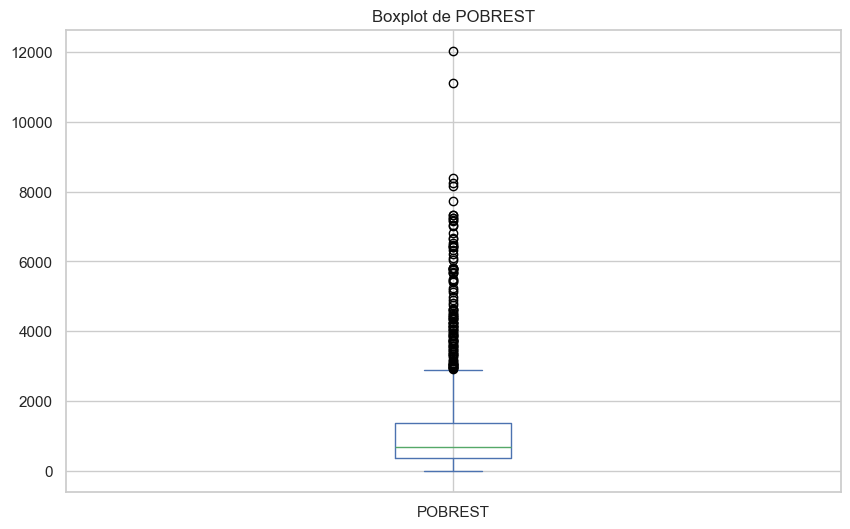

In [96]:
plt.figure(figsize=(10, 6))
gdf['POBREST'].plot(kind='box')
plt.title(f"Boxplot de {'POBREST'}")
plt.show()

In [109]:
# Comparación de estadísticas descriptivas
stats_por_cluster = gdf.groupby('Cluster')['POBREST'].describe()
stats_por_cluster


,count,mean,std,min,25%,50%,75%,max
Cluster,,,,,,,,
0,806.0,1505.076609,1640.404168,0.000000,431.000000,958.380952,1938.291667,12038.000000
1,403.0,702.450688,422.906200,134.727273,396.026786,587.571429,877.522727,2513.666667
2,78.0,118.845972,95.190496,0.000000,30.487715,104.957801,185.904234,333.857143


C:\Users\alexa\AppData\Local\Temp\ipykernel_2284\2737016064.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=gdf, x='Cluster', y='POBREST', palette='magma')


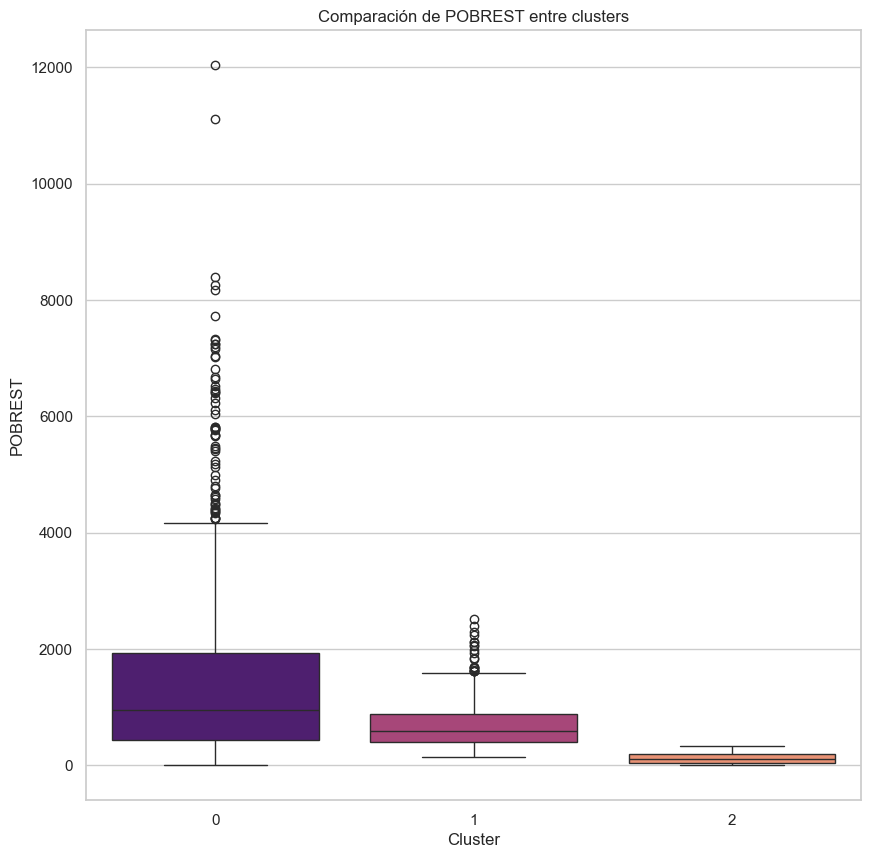

In [106]:
# Visualización de boxplots comparativos de POBREST entre clusters
plt.figure(figsize=(10, 10))
sns.boxplot(data=gdf, x='Cluster', y='POBREST', palette='magma')
plt.title('Comparación de POBREST entre clusters')
plt.xlabel('Cluster')
plt.ylabel('POBREST')
plt.show()

## Análisis de los Clusters en Base al Ratio Población-Restaurantes

### Cluster 0 - Baja Concentración de Restaurantes

En este cluster observamos una distribución de ratios entre población y restaurantes con valores bastante altos en comparación con los otros clusters. Esto sugiere que estas áreas están subatendidas en términos de oferta de restaurantes en relación con la demanda de la población. Aunque algunos valores atípicos superiores indican áreas con una alta concentración de población y pocos restaurantes, lo cual podría sugerir cierto riesgo al abrir nuevos negocios en estas áreas, también podrían representar oportunidades de mercado para emprendimientos gastronómicos que buscan satisfacer una demanda insatisfecha.

Outliers:** En este caso se decidió eliminar los outliers superiores que están significativamente más allá del rango intercuartílico, ya que estos valores  altos pueden no representar adecuadamente la distribución general de los datos y podrían distorsionar el análisis. Además de que pueden ser indicadores de zonas donde puede llegar a no ser muy favorable la apertura de negocios debido a factores de la zona.

### Cluster 1 - Media Concentración de Restaurantes

En este cluster, la distribución de ratios muestra valores intermedios, lo que indica una concentración moderada de restaurantes en relación con la población. Aunque algunos valores atípicos superiores indican áreas con una mayor concentración de población y restaurantes, en general, estas áreas parecen estar bien atendidas en términos de oferta de restaurantes.

### Cluster 2 - Alta Concentración de Restaurantes

En este cluster, la distribución de ratios muestra valores más bajos en comparación con los otros clusters, lo que sugiere una alta concentración de restaurantes en relación con la población. Esto indica que estas áreas ya están bien atendidas en términos de oferta de restaurantes, y abrir nuevos negocios en estas áreas puede enfrentar una competencia intensa. S Sin embargo, también este cluster puede representar zonas aptas para la apertura de restaurantes, como por ejemplo centros comerciales o zonas con alto flujo de personas, donde puede haber cierto tipo de restaurantes no representativos que pueden ser una oportunidad para ofrecer un producto nuevo a los consumidores.

In [125]:
# Eliminar outliers
gdf_sin_outliers = gdf[(gdf['POBREST'] < 5000)]

C:\Users\alexa\AppData\Local\Temp\ipykernel_2284\654230477.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=gdf_sin_outliers, x='Cluster', y='POBREST', palette='magma')


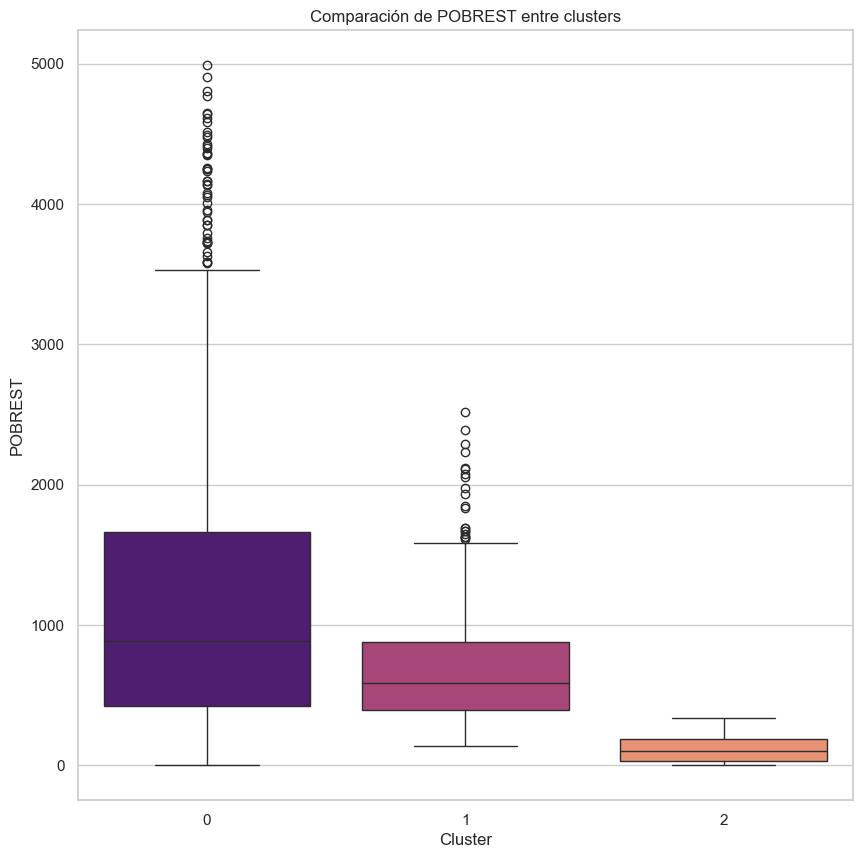

In [121]:
# Visualización de boxplots comparativos de POBREST entre clusters
plt.figure(figsize=(10, 10))
sns.boxplot(data=gdf_sin_outliers, x='Cluster', y='POBREST', palette='magma')
plt.title('Comparación de POBREST entre clusters')
plt.xlabel('Cluster')
plt.ylabel('POBREST')
plt.show()

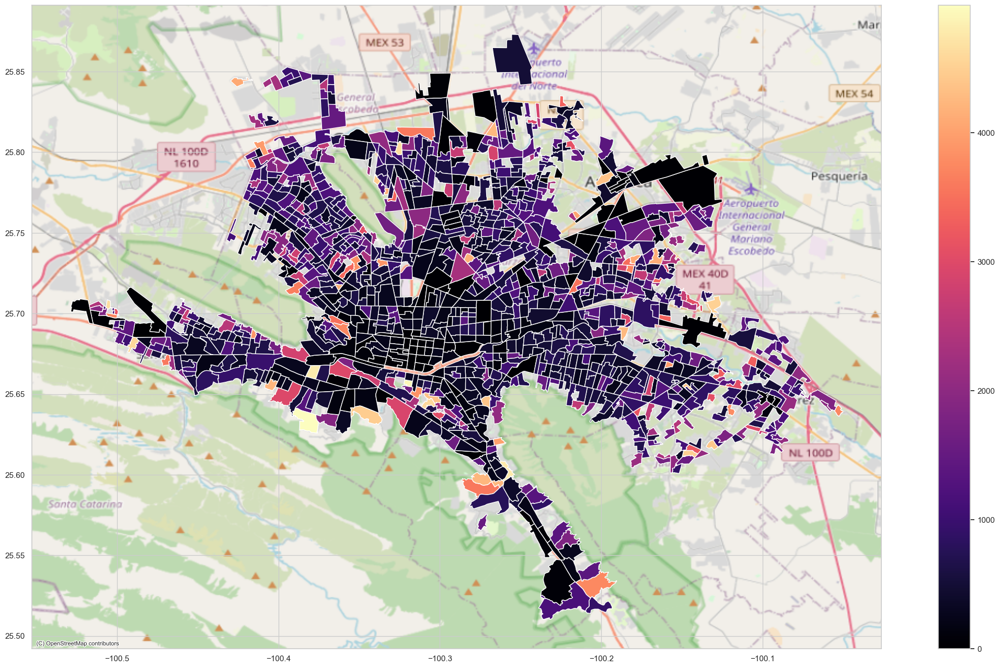

In [122]:
#mostrar Relación Pob Rest eliminando los outliers
ax = gdf_sin_outliers.plot("POBREST", cmap="magma", legend=True, figsize=(28, 16))
cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.OpenStreetMap.Mapnik)

In [123]:
#conteo de clusters después de filtrar 
gdf_sin_outliers['Cluster'].value_counts()

Cluster
0    764
1    403
2     78
Name: count, dtype: int64

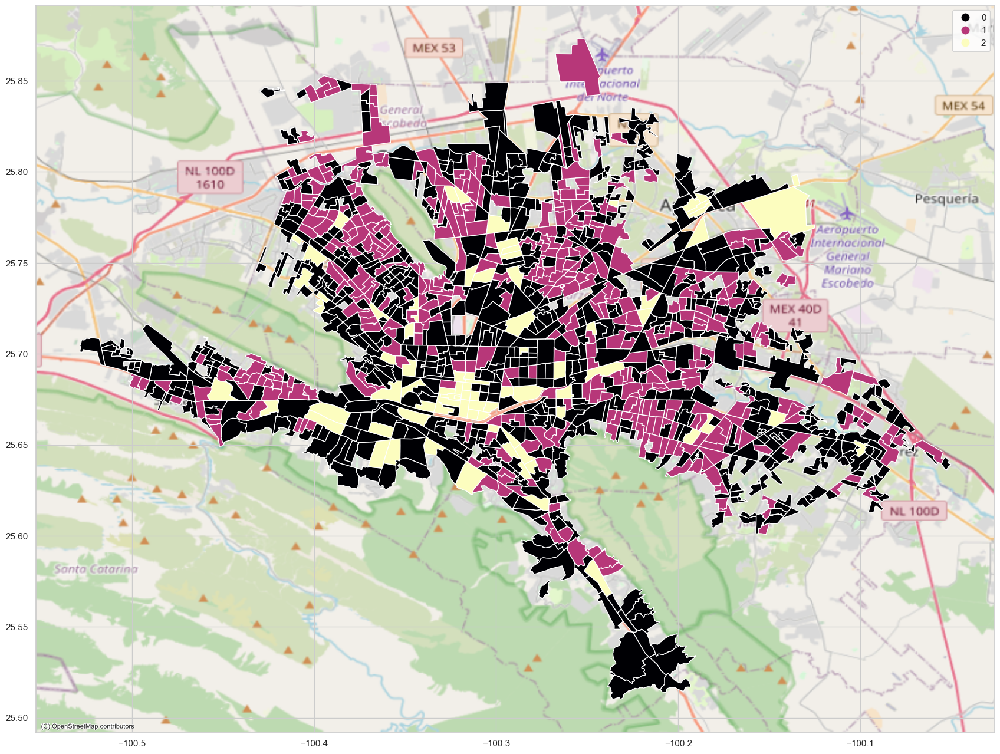

In [126]:
#mostrar Clusters eliminando los outliers
ax = gdf_sin_outliers.plot("Cluster", cmap="magma", legend=True, figsize=(28, 16), categorical = True)
cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.OpenStreetMap.Mapnik)

# SELECCIÓN DE AGEBS CON MAYOR PERSONAS POR RESTAURANTE PARA CADA CLUSTER

Ahora que ya se analizaron los clusters en base al Ratio Población-Restaurantes y se comprende cómo se pueden identificar oportunidades para satisfacer la demanda de los consumidores, se seleccionarán los 3 AGEBs con mayor ratio para cada cluster:

In [128]:
# Agrupar los datos por cluster
cluster_groups = gdf_sin_outliers.groupby('Cluster')

# Crear un diccionario para almacenar los top 3 AGEBS por cluster
top_agebs = {}

# Iterar sobre cada cluster
for cluster, data in cluster_groups:
    # Ordenar los datos por la relación de personas por restaurante en orden descendente
    sorted_data = data.sort_values(by='POBREST', ascending=False)
    # Tomar los top 3 AGEBS para este cluster
    top_agebs[cluster] = sorted_data.head(3)['CVEMA'].tolist()

# Imprimir los top 3 AGEBS para cada cluster
for cluster, agebs in top_agebs.items():
    print(f"Cluster {cluster}: {agebs}")

Cluster 0: ['0190505', '0391968', '019005A']
Cluster 1: ['0481312', '0210749', '0211713']
Cluster 2: ['0210202', '0480579', '0262154']


In [129]:
#Leer DENUE
denue_path = r'socio\DENUE_11_2023_zip\conjunto_de_datos\denue_inegi_19_.shp'
denue = gpd.read_file(denue_path)

In [148]:
#agrego una columna de identificación compuesta por el número de MUNICIPIO y AGEB
denue['CVEMA'] = denue['cve_mun'].map(str).str.zfill(3) + denue['ageb'].map(str).str.zfill(4)

#filtro para restaurantes
denue = denue[denue['nombre_act'].str.contains('restaurant', case=False, na=False)]


In [149]:
# Inicializar una lista para almacenar los DataFrames filtrados
dfs = []

# Iterar sobre cada cluster y sus AGEBS de interés
for cluster, agebs in top_agebs.items():
    # Filtrar denue para los AGEBS de interés en este cluster
    df_temp = denue[denue['CVEMA'].isin(agebs)]
    # Agregar el DataFrame filtrado a la lista
    dfs.append(df_temp)

# Concatenar todos los DataFrames en uno solo
denue_filtrado = pd.concat(dfs, ignore_index=True)


In [150]:
#solo mantengo columnas relevantes
d_rest = denue_filtrado[['nom_estab','nombre_act','latitud', 'longitud','geometry', 'CVEMA']]

In [200]:
d_rest.head()

,nom_estab,nombre_act,latitud,longitud,geometry,CVEMA
0,COQUELET VENTA DE COMIDA,Restaurantes que preparan otro tipo de aliment...,25.637310,-100.377297,POINT (-100.37730 25.63731),0190505
1,MACHACADO CON HUEVO GARCIA EXPRESS,Restaurantes con servicio de preparación de al...,25.663753,-100.381651,POINT (-100.38165 25.66375),019005A
2,POLLOS ASADOS LOS PRIMOS,Restaurantes con servicio de preparación de pi...,25.656716,-100.320335,POINT (-100.32033 25.65672),0391968
3,EL POLLO LEÑERO,Restaurantes con servicio de preparación de pi...,25.688148,-100.434839,POINT (-100.43484 25.68815),0481312
4,ALITAS TENDERS BONELES Y PAPAS,Restaurantes con servicio de preparación de pi...,25.689022,-100.434527,POINT (-100.43453 25.68902),0481312


In [153]:
# Crear un diccionario para almacenar los DataFrames agrupados por 'CVEMA'
dfs_cvema = {}

# Iterar sobre cada grupo de 'CVEMA' y sus datos correspondientes
for cvema, group_df in d_rest.groupby('CVEMA'):
    # Almacenar el DataFrame correspondiente en el diccionario
    dfs_cvema[cvema] = group_df

# FUNCIÓN PARA GRAFICAR AGEBS CON RESTAURANTES

In [217]:
def plot_ageb(clave):
    # Obtener el DataFrame correspondiente al AGEBS
    df_ageb = dfs_cvema[clave]

    # Obtener el shape correspondiente al AGEBS del DataFrame gdf
    shape_ageb = gdf[gdf['CVEMA'] == clave]

    # Crear la figura y los ejes
    fig, ax = plt.subplots(figsize=(10, 9))

    # Mostrar el shape del AGEBS
    shape_ageb.plot(ax=ax, color='none', edgecolor='red', alpha=1, linewidth=4)

    # Graficar los puntos del DataFrame df_ageb con colores según el cluster
    for cluster_id, cluster_data in df_ageb.groupby('cluster'):
        plt.scatter(cluster_data['longitud'], cluster_data['latitud'], label=f'Cluster {cluster_id}', alpha=1)

    # Obtener los handles y labels para la leyenda
    handles, labels = plt.gca().get_legend_handles_labels()

    # Crear la leyenda
    plt.legend(handles=handles, labels=labels)

    # Agregar título y etiquetas de los ejes
    plt.title(f'AGEB {clave}')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')

    # Mostrar el mapa de fondo
    cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.CartoDB.Voyager)

    # Mostrar el gráfico
    plt.show()

# HACER CLUSTERS PARA RESTAURANTES DENTRO DE CADA AGEB USANDO DBSCAN

Para el AGEBS 019005A se encontraron 1 clusters. Hay 1 restaurantes


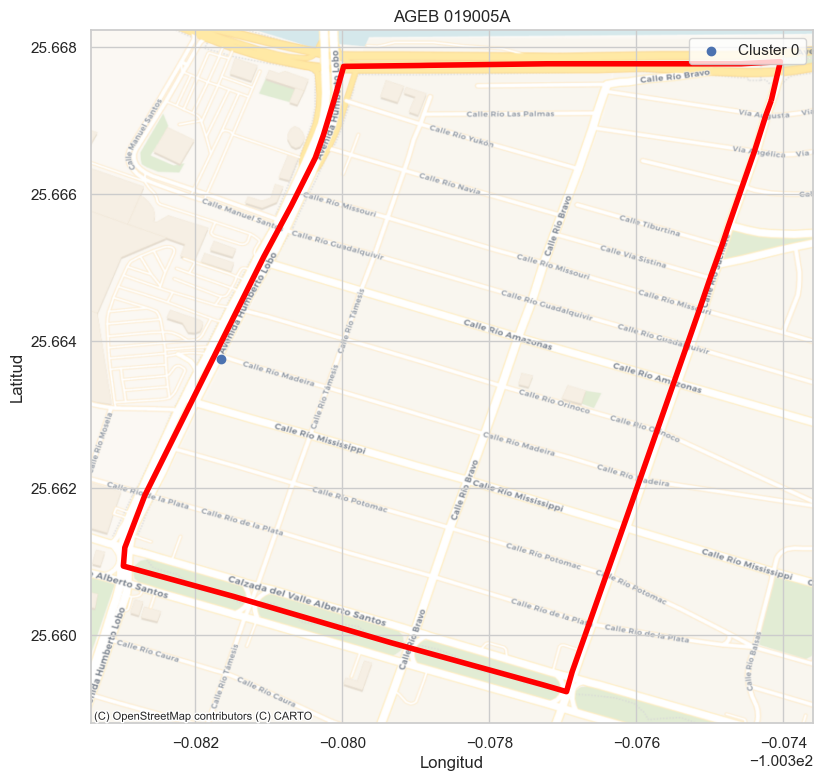

Para el AGEBS 0190505 se encontraron 1 clusters. Hay 1 restaurantes


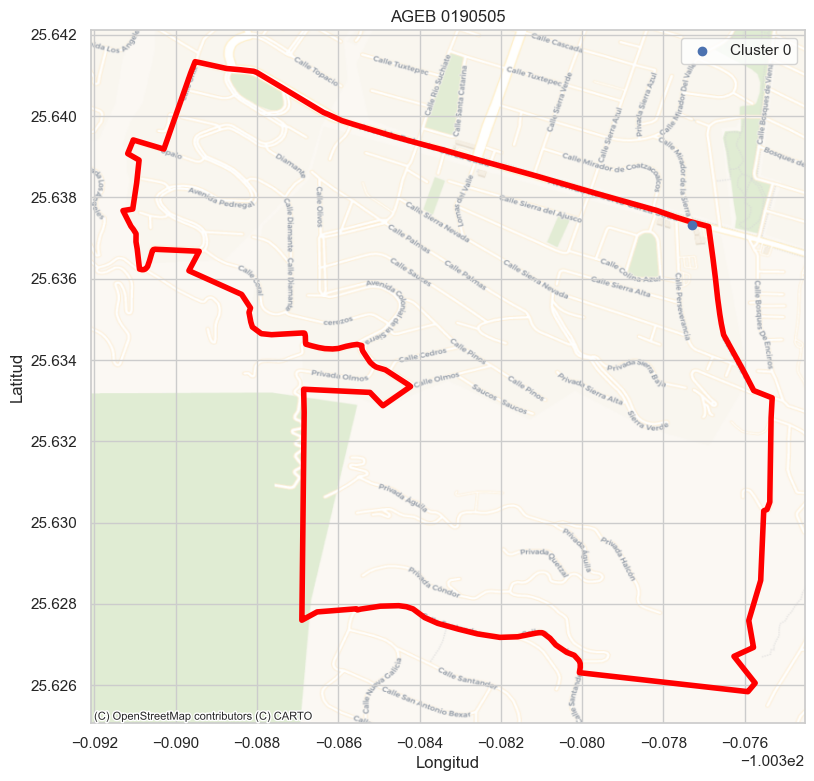

Para el AGEBS 0210202 se encontraron 8 clusters. Hay 28 restaurantes


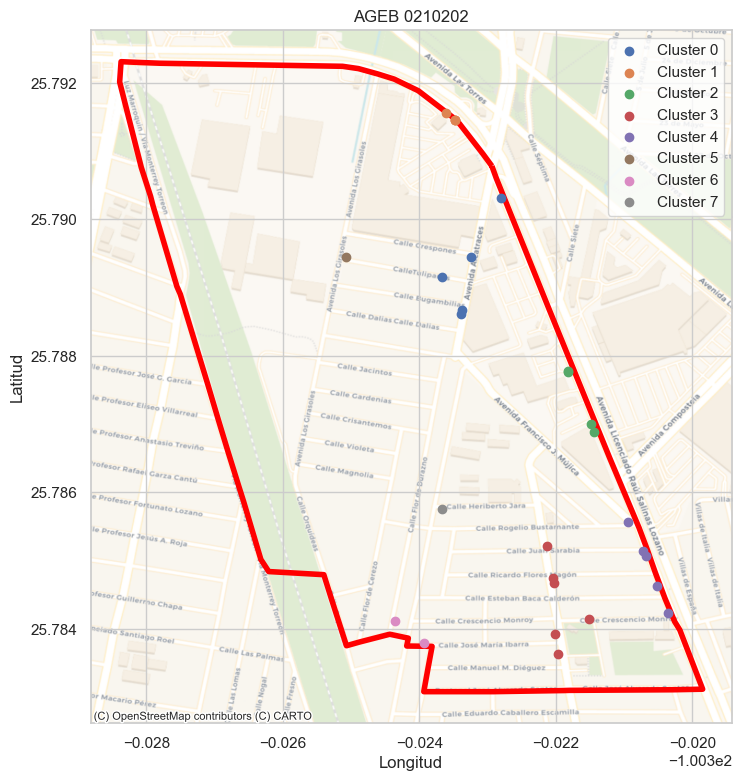

Para el AGEBS 0210749 se encontraron 4 clusters. Hay 5 restaurantes


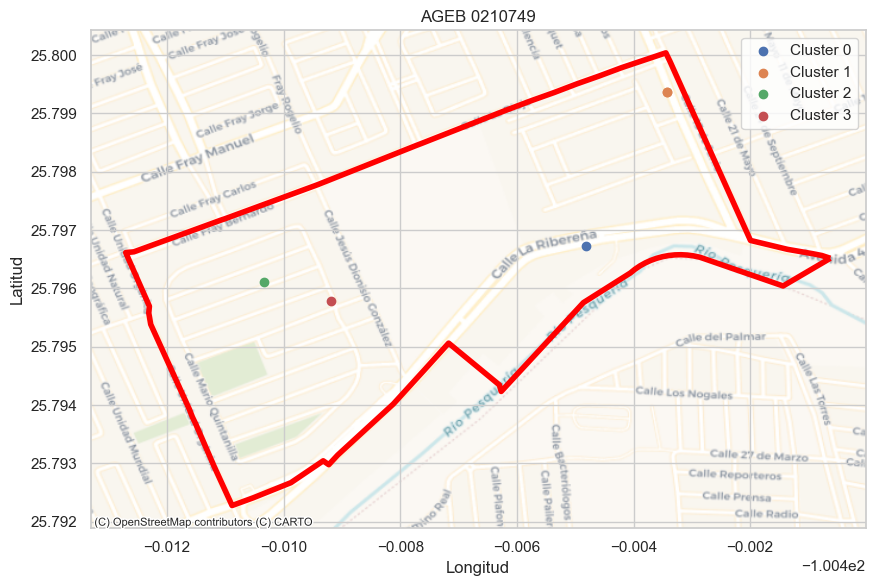

Para el AGEBS 0211713 se encontraron 4 clusters. Hay 8 restaurantes


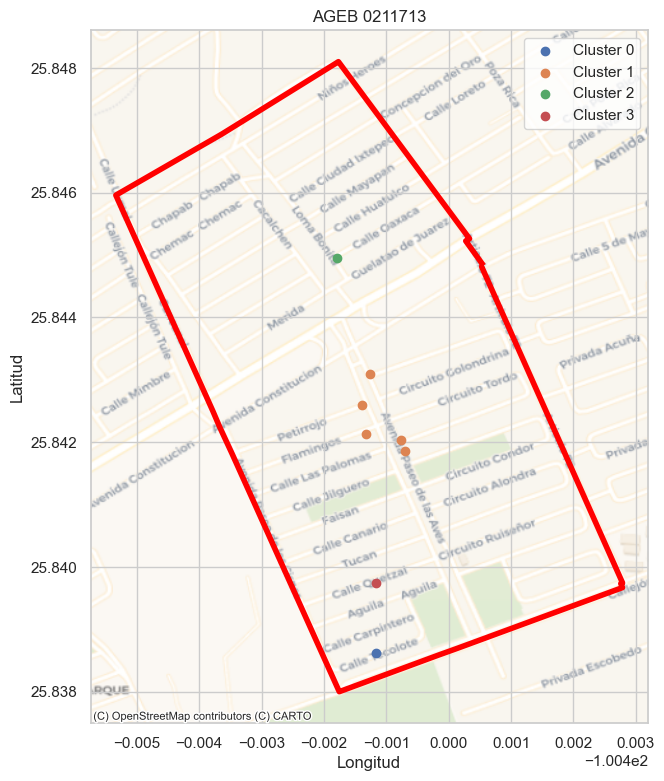

Para el AGEBS 0262154 se encontraron 8 clusters. Hay 19 restaurantes


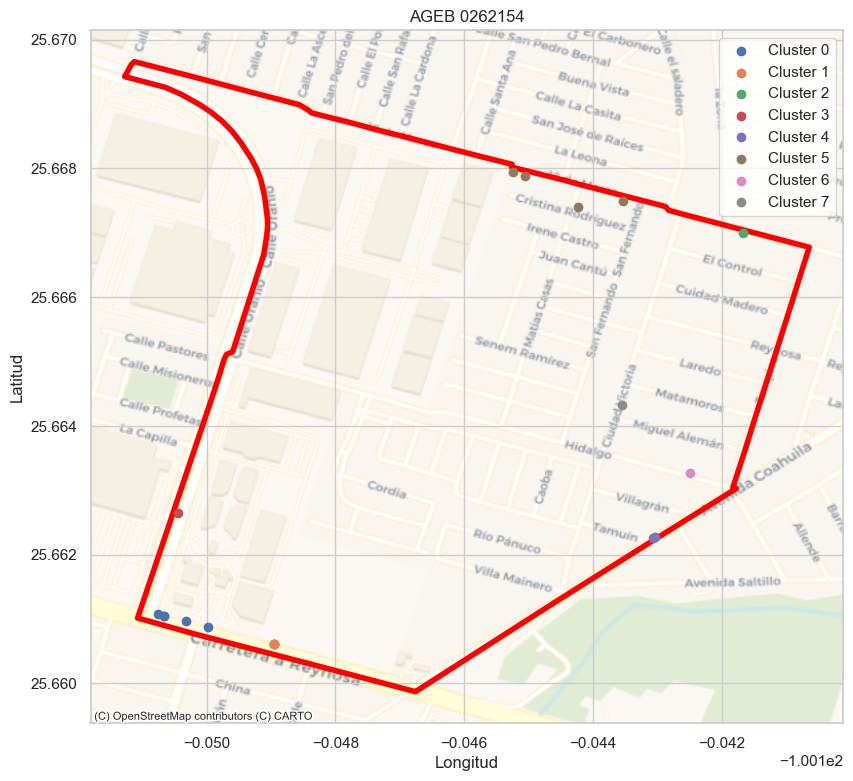

Para el AGEBS 0391968 se encontraron 1 clusters. Hay 1 restaurantes


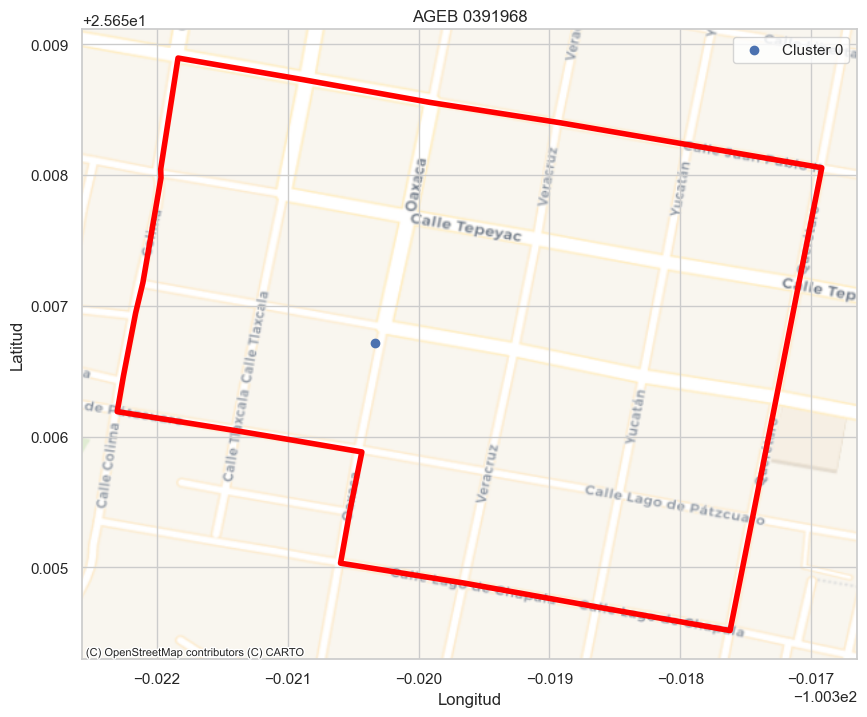

Para el AGEBS 0480579 se encontraron 8 clusters. Hay 20 restaurantes


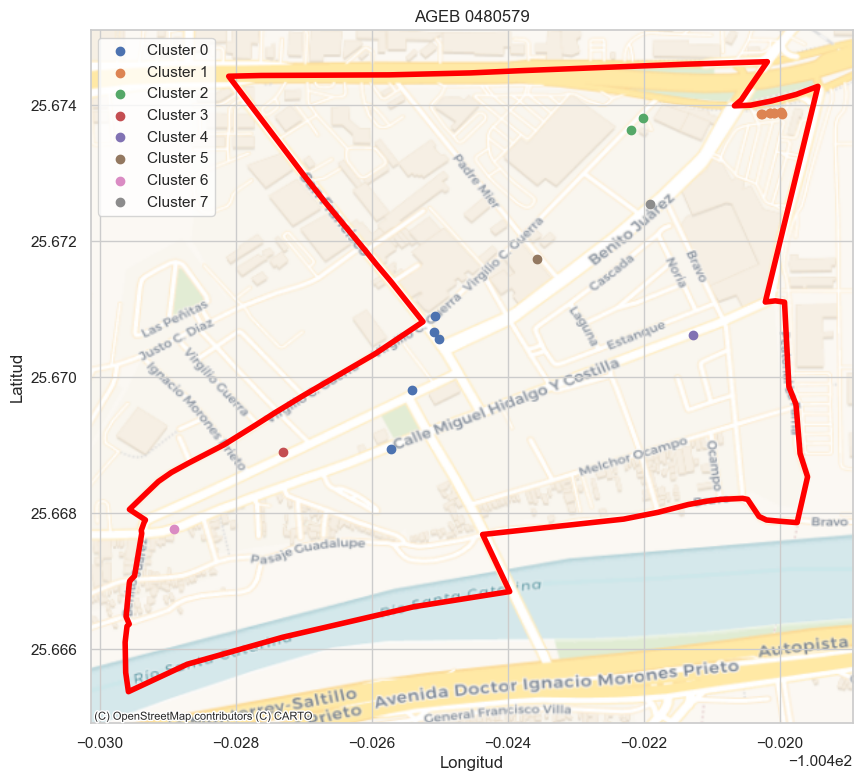

Para el AGEBS 0481312 se encontraron 2 clusters. Hay 6 restaurantes


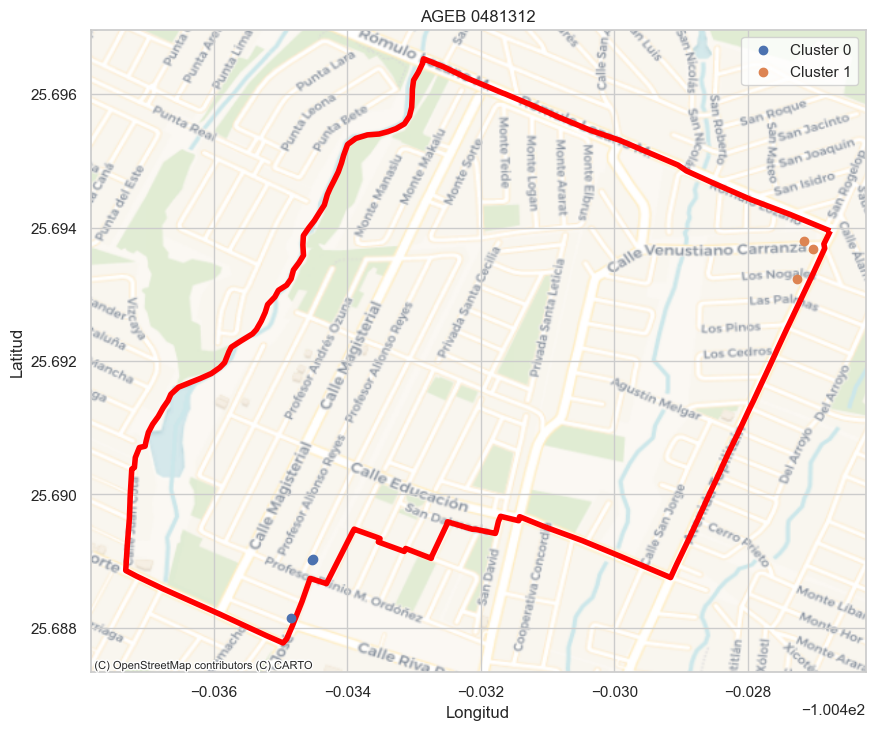

In [210]:
from sklearn.cluster import DBSCAN
from sklearn.metrics.pairwise import euclidean_distances

# Parámetros para DBSCAN
epsilon = 0.001  # Distancia máxima entre dos muestras para que una sea considerada en el vecindario de la otra

# Iterar sobre cada DataFrame de AGEBS
for ageb_id, df_ageb in dfs_cvema.items():
    # Verificar si el DataFrame contiene datos de restaurantes
    if 'latitud' in df_ageb.columns and 'longitud' in df_ageb.columns:
        # Extraer las coordenadas de latitud y longitud de los restaurantes
        coords = df_ageb[['latitud', 'longitud']].values
        
        # Calcular la matriz de distancias euclidianas
        distances = euclidean_distances(coords)
        
        # Establecer min_samples como 1 para asegurar que ningún punto quede excluido de los clusters
        min_samples = 1
        
        # Aplicar DBSCAN para realizar el clustering
        dbscan = DBSCAN(eps=epsilon, min_samples=min_samples, metric='precomputed')
        clusters = dbscan.fit_predict(distances)
        
        # Almacenar los resultados del clustering en una nueva columna
        df_ageb['cluster'] = clusters
        
        # Informar sobre el número de clusters encontrados
        n_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
        print(f"Para el AGEBS {ageb_id} se encontraron {n_clusters} clusters. Hay {df_ageb.shape[0]} restaurantes")
        
    plot_ageb(ageb_id)
